In [1]:
import pandas as pd

In [2]:
path='fuel-type-data_ciso.csv'

In [3]:
import os
os.getcwd()

'c:\\Users\\basil\\Documents\\Time-Series-Forecasting-Python-\\4_Assignment'

In [4]:
df_c = pd.read_csv(path)
df_c

,period,respondent,respondent-name,fueltype,type-name,value,value-units
0,2025-09-02 23:00:00-07:00,CISO,California Independent System Operator,COL,Coal,0.0,megawatthours
1,2025-09-02 23:00:00-07:00,CISO,California Independent System Operator,NG,Natural Gas,18057.0,megawatthours
2,2025-09-02 23:00:00-07:00,CISO,California Independent System Operator,NUC,Nuclear,2258.0,megawatthours
3,2025-09-02 23:00:00-07:00,CISO,California Independent System Operator,OIL,Petroleum,46.0,megawatthours
4,2025-09-02 23:00:00-07:00,CISO,California Independent System Operator,OTH,Other,5169.0,megawatthours
...,...,...,...,...,...,...,...
451921,2018-12-31 16:00:00-08:00,CISO,California Independent System Operator,OIL,Petroleum,88.0,megawatthours
451922,2018-12-31 16:00:00-08:00,CISO,California Independent System Operator,OTH,Other,-22.0,megawatthours
451923,2018-12-31 16:00:00-08:00,CISO,California Independent System Operator,SUN,Solar,1222.0,megawatthours
451924,2018-12-31 16:00:00-08:00,CISO,California Independent System Operator,WAT,Hydro,2403.0,megawatthours


#### Preprocess data

In [5]:
COLUMN_DATETIME = "period"
TIMEZONE = "America/Los_Angeles"

x = pd.to_datetime(df_c[COLUMN_DATETIME], utc=True)
x = x.dt.tz_convert(TIMEZONE)

df_c[COLUMN_DATETIME] = x
x

0        2025-09-02 23:00:00-07:00
1        2025-09-02 23:00:00-07:00
2        2025-09-02 23:00:00-07:00
3        2025-09-02 23:00:00-07:00
4        2025-09-02 23:00:00-07:00
                    ...           
451921   2018-12-31 16:00:00-08:00
451922   2018-12-31 16:00:00-08:00
451923   2018-12-31 16:00:00-08:00
451924   2018-12-31 16:00:00-08:00
451925   2018-12-31 16:00:00-08:00
Name: period, Length: 451926, dtype: datetime64[ns, America/Los_Angeles]

In [6]:
df_c.isnull().sum()

period               0
respondent           0
respondent-name      0
fueltype             0
type-name            0
value              154
value-units          0
dtype: int64

In [7]:
df_c['value'] = df_c['value'].fillna(df_c['value'].mean())

In [8]:
df_c.isnull().sum()

period             0
respondent         0
respondent-name    0
fueltype           0
type-name          0
value              0
value-units        0
dtype: int64

In [9]:
df_c[COLUMN_DATETIME] = x

#### Available series inside dataset

In [10]:
COLUMN_CATEGORIES = ['respondent','respondent-name','fueltype','type-name']

df_c[COLUMN_CATEGORIES].drop_duplicates().style

,respondent,respondent-name,fueltype,type-name
0,CISO,California Independent System Operator,COL,Coal
1,CISO,California Independent System Operator,NG,Natural Gas
2,CISO,California Independent System Operator,NUC,Nuclear
3,CISO,California Independent System Operator,OIL,Petroleum
4,CISO,California Independent System Operator,OTH,Other
5,CISO,California Independent System Operator,SUN,Solar
6,CISO,California Independent System Operator,WAT,Hydro
7,CISO,California Independent System Operator,WND,Wind


#### Set index <br> The index is composed by the columns that uniquely identify the rows. The datetime column must be present.

In [11]:
COLUMN_CATEGORIES = ['respondent-name','type-name']

idx = COLUMN_CATEGORIES + [COLUMN_DATETIME]
x = df_c.set_index(idx).sort_index()
x

respondent  \
respondent-name                        type-name period                                 
California Independent System Operator Coal      2018-12-31 16:00:00-08:00       CISO   
                                                 2018-12-31 17:00:00-08:00       CISO   
                                                 2018-12-31 18:00:00-08:00       CISO   
                                                 2018-12-31 19:00:00-08:00       CISO   
                                                 2018-12-31 20:00:00-08:00       CISO   
...                                                                               ...   
                                       Wind      2025-09-02 19:00:00-07:00       CISO   
                                                 2025-09-02 20:00:00-07:00       CISO   
                                                 2025-09-02 21:00:00-07:00       CISO   
                                                 2025-09-02 22:00:00-07:00       CISO   
                                                 2025-09-02 23:00:00-07:00       CISO   

                                                                           fueltype  \
respondent-name                        type-name period                               
California Independent System Operator Coal      2018-12-31 16:00:00-08:00      COL   
                                                 2018-12-31 17:00:00-08:00      COL   
                                                 2018-12-31 18:00:00-08:00      COL   
                                                 2018-12-31 19:00:00-08:00      COL   
                                                 2018-12-31 20:00:00-08:00      COL   
...                                                                             ...   
                                       Wind      2025-09-02 19:00:00-07:00      WND   
                                                 2025-09-02 20:00:00-07:00      WND   
                                                 2025-09-02 21:00:00-07:00      WND   
                                                 2025-09-02 22:00:00-07:00      WND   
                                                 2025-09-02 23:00:00-07:00      WND   

                                                                            value  \
respondent-name                        type-name period                             
California Independent System Operator Coal      2018-12-31 16:00:00-08:00    9.0   
                                                 2018-12-31 17:00:00-08:00   11.0   
                                                 2018-12-31 18:00:00-08:00   11.0   
                                                 2018-12-31 19:00:00-08:00   10.0   
                                                 2018-12-31 20:00:00-08:00   10.0   
...                                                                           ...   
                                       Wind      2025-09-02 19:00:00-07:00  891.0   
                                                 2025-09-02 20:00:00-07:00  961.0   
                                                 2025-09-02 21:00:00-07:00  758.0   
                                                 2025-09-02 22:00:00-07:00  801.0   
                                                 2025-09-02 23:00:00-07:00  882.0   

                                                                              value-units  
respondent-name                        type-name period                                    
California Independent System Operator Coal      2018-12-31 16:00:00-08:00  megawatthours  
                                                 2018-12-31 17:00:00-08:00  megawatthours  
                                                 2018-12-31 18:00:00-08:00  megawatthours  
                                                 2018-12-31 19:00:00-08:00  megawatthours  
                                                 2018-12-31 20:00:00-08:00  megawatthours  
...                                

In [12]:
x.index.is_unique

True

In [13]:
df = x.copy()

#### Select values column

In [14]:
COLUMN_VALUES = "value"
x = df[COLUMN_VALUES]
x

respondent-name                         type-name  period                   
California Independent System Operator  Coal       2018-12-31 16:00:00-08:00      9.0
                                                   2018-12-31 17:00:00-08:00     11.0
                                                   2018-12-31 18:00:00-08:00     11.0
                                                   2018-12-31 19:00:00-08:00     10.0
                                                   2018-12-31 20:00:00-08:00     10.0
                                                                                ...  
                                        Wind       2025-09-02 19:00:00-07:00    891.0
                                                   2025-09-02 20:00:00-07:00    961.0
                                                   2025-09-02 21:00:00-07:00    758.0
                                                   2025-09-02 22:00:00-07:00    801.0
                                                   2025-09-02 2

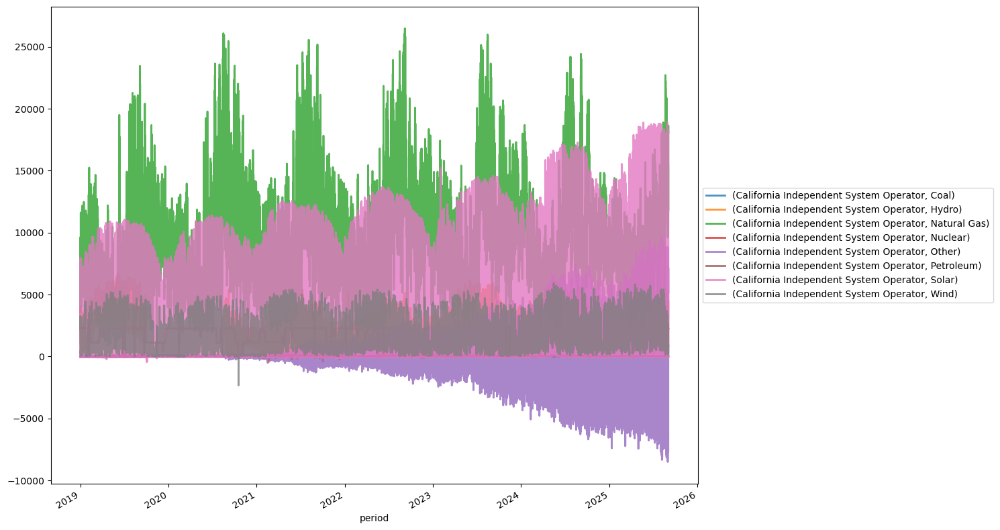

In [15]:
plot = x.unstack(level=COLUMN_CATEGORIES).plot(figsize=(15, 8), linewidth=2, alpha=0.8)
plot.legend(loc="center left", bbox_to_anchor=(1, 0.5))
plot.figure.tight_layout()

In [16]:
series = x.copy()

##### Filter one time series <br> To get a table with unique datetime index of the series, and the time series values

In [17]:
CATEGORIES = ('California Independent System Operator','Hydro')
x = series.loc[CATEGORIES]
x

period
2018-12-31 16:00:00-08:00    2403.0
2018-12-31 17:00:00-08:00    3328.0
2018-12-31 18:00:00-08:00    3539.0
2018-12-31 19:00:00-08:00    3480.0
2018-12-31 20:00:00-08:00    3192.0
                              ...  
2025-09-02 19:00:00-07:00    3807.0
2025-09-02 20:00:00-07:00    4352.0
2025-09-02 21:00:00-07:00    4178.0
2025-09-02 22:00:00-07:00    4382.0
2025-09-02 23:00:00-07:00    4401.0
Name: value, Length: 50577, dtype: float64

In [18]:
import sys
print(sys.executable)

c:\Users\basil\Anaconda\python.exe


In [19]:
import sys
sys.path.append('../modules')  # go up one folder, then into "modules"

import utils
utils.configure_plotly_template(showlegend=True)

In [20]:
x.plot()

In [21]:
series = x.copy()

#### Aggregate

**Check if you need to aggregate your data:**

- ✅ **Keep as-is** if data is already at appropriate frequency (monthly, quarterly, etc.)
- 🔄 **Aggregate first** if data is too granular for your seasonal question:
  - **Annual seasonality** → Aggregate to monthly
  - **Weekly patterns** → Aggregate to daily  
  - **Daily patterns** → Aggregate to hourly

**Rule of Thumb:**

Match your data frequency to the seasonal cycle you want to study. Most seasonal business analysis works best with **monthly data** to capture yearly patterns.

**Note**: You need at least 3-5 complete seasonal cycles for reliable decomposition results.

In [22]:
RULE = '1W'
x = series.resample(RULE).sum()
x

period
2019-01-06 00:00:00-08:00    296798.000000
2019-01-13 00:00:00-08:00    263562.000000
2019-01-20 00:00:00-08:00    296814.000000
2019-01-27 00:00:00-08:00    314203.000000
2019-02-03 00:00:00-08:00    360945.118662
                                 ...      
2025-08-10 00:00:00-07:00    482144.000000
2025-08-17 00:00:00-07:00    459922.000000
2025-08-24 00:00:00-07:00    506388.000000
2025-08-31 00:00:00-07:00    430510.000000
2025-09-07 00:00:00-07:00    128533.000000
Freq: W-SUN, Name: value, Length: 349, dtype: float64

In [23]:
x.plot()

### Filter datetime range

<div class="alert alert-warning">
Not necessary if you are interested in the whole time series. Although, it's advised to filter out outliers and incomplete data to get full periods, like full years, months, etc.
</div>

In [24]:
START, END = '2021','2024'


In [25]:
x = series.loc[START:END]
x

period
2021-01-01 00:00:00-08:00     845.0
2021-01-01 01:00:00-08:00     782.0
2021-01-01 02:00:00-08:00     729.0
2021-01-01 03:00:00-08:00     737.0
2021-01-01 04:00:00-08:00     763.0
                              ...  
2024-12-31 19:00:00-08:00    2699.0
2024-12-31 20:00:00-08:00    3030.0
2024-12-31 21:00:00-08:00    3171.0
2024-12-31 22:00:00-08:00    2982.0
2024-12-31 23:00:00-08:00    2838.0
Name: value, Length: 35017, dtype: float64

In [26]:
x.plot()

In [27]:
series = x.copy()

## Individual component behaviour based on model

Components:

- Trend (T)
- Seasonality (S)
- Residual or Irregular Component (I)

Models:

- Additive model: $y_t = T_t + S_t + e_t$
- Multiplicative model: $y_t = T_t \times S_t \times e_t$

##### Additive model

In [28]:
import statsmodels.api as sm

In [29]:
PERIOD = 52
result = sm.tsa.seasonal_decompose(series, model='additive',period=PERIOD)
x = (x
  .to_frame()
  .assign(
      trend = result.trend,
      seasonal = result.seasonal,
      residual = result.resid)
  .dropna())    
x

,value,trend,seasonal,residual
period,,,,
2021-01-02 02:00:00-08:00,691.0,1030.211538,39.183883,-378.395422
2021-01-02 03:00:00-08:00,698.0,1031.019231,9.762706,-342.781937
2021-01-02 04:00:00-08:00,767.0,1034.826923,3.395822,-271.222745
2021-01-02 05:00:00-08:00,846.0,1040.769231,26.359460,-221.128691
2021-01-02 06:00:00-08:00,1069.0,1047.711538,43.550682,-22.262221
...,...,...,...,...
2024-12-30 17:00:00-08:00,1632.0,2173.807692,9.996038,-551.803730
2024-12-30 18:00:00-08:00,2468.0,2206.067308,-22.989194,284.921886
2024-12-30 19:00:00-08:00,2602.0,2238.730769,-29.005396,392.274626


In [30]:
x['model_result'] = x.trend+x.seasonal+x.residual
x

,value,trend,seasonal,residual,model_result
period,,,,,
2021-01-02 02:00:00-08:00,691.0,1030.211538,39.183883,-378.395422,691.0
2021-01-02 03:00:00-08:00,698.0,1031.019231,9.762706,-342.781937,698.0
2021-01-02 04:00:00-08:00,767.0,1034.826923,3.395822,-271.222745,767.0
2021-01-02 05:00:00-08:00,846.0,1040.769231,26.359460,-221.128691,846.0
2021-01-02 06:00:00-08:00,1069.0,1047.711538,43.550682,-22.262221,1069.0
...,...,...,...,...,...
2024-12-30 17:00:00-08:00,1632.0,2173.807692,9.996038,-551.803730,1632.0
2024-12-30 18:00:00-08:00,2468.0,2206.067308,-22.989194,284.921886,2468.0
2024-12-30 19:00:00-08:00,2602.0,2238.730769,-29.005396,392.274626,2602.0


In [31]:
dfs = {}
dfs['additive']=x

#### Multiplicative Model

In [32]:
series_adjusted = series.copy()
series_adjusted[series_adjusted <= 0] = 0.01  # or some small number

result = sm.tsa.seasonal_decompose(series_adjusted, model='multiplicative', period=PERIOD)

x = (series
 .to_frame()
 .assign(
    trend = result.trend,
    seasonal = result.seasonal,
    residual = result.resid)
 .dropna())

x

,value,trend,seasonal,residual
period,,,,
2021-01-02 02:00:00-08:00,691.0,1030.211538,1.023163,0.655551
2021-01-02 03:00:00-08:00,698.0,1031.019231,1.005006,0.673628
2021-01-02 04:00:00-08:00,767.0,1034.826923,0.998717,0.742139
2021-01-02 05:00:00-08:00,846.0,1040.769231,1.013620,0.801938
2021-01-02 06:00:00-08:00,1069.0,1047.711538,1.022826,0.997549
...,...,...,...,...
2024-12-30 17:00:00-08:00,1632.0,2173.807692,1.011211,0.742433
2024-12-30 18:00:00-08:00,2468.0,2206.067308,0.989156,1.130997
2024-12-30 19:00:00-08:00,2602.0,2238.730769,0.980395,1.185507


In [33]:
x['model_result'] = x.trend * x.seasonal * x.residual
x

,value,trend,seasonal,residual,model_result
period,,,,,
2021-01-02 02:00:00-08:00,691.0,1030.211538,1.023163,0.655551,691.0
2021-01-02 03:00:00-08:00,698.0,1031.019231,1.005006,0.673628,698.0
2021-01-02 04:00:00-08:00,767.0,1034.826923,0.998717,0.742139,767.0
2021-01-02 05:00:00-08:00,846.0,1040.769231,1.013620,0.801938,846.0
2021-01-02 06:00:00-08:00,1069.0,1047.711538,1.022826,0.997549,1069.0
...,...,...,...,...,...
2024-12-30 17:00:00-08:00,1632.0,2173.807692,1.011211,0.742433,1632.0
2024-12-30 18:00:00-08:00,2468.0,2206.067308,0.989156,1.130997,2468.0
2024-12-30 19:00:00-08:00,2602.0,2238.730769,0.980395,1.185507,2602.0


In [34]:
dfs['multiplicative'] = x

#### Model Comparison
###### Numerical

In [ ]:
df_com = pd.concat(dfs,axis=1).melt(ignore_index=False).reset_index()
df_com.columns = ["month", "model", "component", "value"]


In [42]:
import plotly.express as px

fig = px.line(
    data_frame=df_com,
    x='month',
    y='value',
    color='component',
    facet_col='model',
    facet_row='component',
    width=1000,
    height=500,
    facet_col_spacing=0.1,
)

fig.update_yaxes(matches=None)

for attr in dir(fig.layout):
    if attr.startswith("yaxis"):
        axis = getattr(fig.layout, attr)
        if axis:
            axis.showticklabels = True
        
fig